## Imports

In [1]:
import pandas as pd
import matplotlib.pyplot as plt
import numpy as np
from scipy import fft
import plotly.graph_objects as go

# [MAFAULDA Data](http://www02.smt.ufrj.br/~offshore/mfs/page_01.html#SEC2)

* rate sample: 50kHz

* time of sample: 5s

* total samples: 250 000

* 6 different simulated states: normal function, imbalance fault, horizontal and vertical misalignment faults and, inner and outer bearing faults

* 49 rotation frequencies



In [2]:
fs = 50000
total_sample =5
Ts=1/fs
#creating a vector of time
t = np.arange(0,total_sample,Ts)
print(t.shape)

(250000,)


* column 0: 
tachometer signal that allows to estimate rotation frequency;

* columns 1 to 3:
underhang bearing accelerometer (axial, radiale and tangential direction);

* columns 4 to 6:
overhang bearing accelerometer (axial, radiale and tangential direction);

* column 7:
microphone.

![](http://azimadli.com/vibman/_aintroduction%20to%20machine%20vibration-65.png)



# Reading Data

In [3]:
#reading data from google drive
#if you are in jupyter notebook this may not work as intended
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [4]:
#reading a test file from MAFAULDA > Normal > 12... .csv
PATH = '/content/drive/My Drive/UFPR/TCC/Python/Testes/'
n12 = pd.read_csv(PATH+ '1229.csv', header=None)
display(n12.head())
n12.shape

,0,1,2,3,4,5,6,7
0,4.5595,0.175200,0.287210,-0.017751,-0.41565,0.032459,-0.11218,-0.128140
1,4.6038,-0.051295,-0.194050,-0.060071,-0.41809,0.036547,-0.11043,0.118310
2,4.5703,-0.969080,0.038033,-0.028329,-0.43081,0.041924,-0.14331,-0.071527
3,4.5870,0.891270,0.072973,0.007453,-0.40017,0.041090,-0.11984,0.043445
4,4.5887,-1.716000,-0.329290,-0.033063,-0.50281,0.040474,-0.25270,0.023901


(250000, 8)

# Columns Analysis

In [6]:
#creating a function to read MAFAULDA csv files with correct columns names
def read_file(file):
  columns = ['tachometer', 'axial_1','radiale_1', 'tangential_1','axial_2','radiale_2', 'tangential_2','microphone']
  return pd.read_csv(file, header=None, names=columns)

## Tachometer

,tachometer,axial_1,radiale_1,tangential_1,axial_2,radiale_2,tangential_2,microphone
0,4.5595,0.175200,0.287210,-0.017751,-0.41565,0.032459,-0.11218,-0.128140
1,4.6038,-0.051295,-0.194050,-0.060071,-0.41809,0.036547,-0.11043,0.118310
2,4.5703,-0.969080,0.038033,-0.028329,-0.43081,0.041924,-0.14331,-0.071527


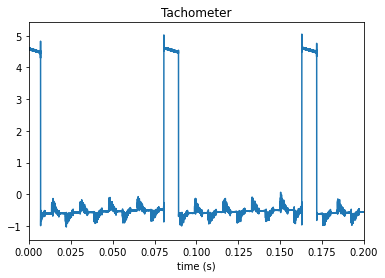

In [9]:
n12 = read_file(PATH+ '1229.csv')
display(n12.head(3))
plt.plot(t,n12.tachometer)
plt.xlim(0,0.2)
plt.xlabel('time (s)')
plt.title('Tachometer')
plt.show()


### Loading 2 more exemples of MAFAULDA Normal files

In [10]:
tac1229= read_file(PATH+ '1229.csv')
tac6144=read_file(PATH+ '6144.csv')

### Filtering the signal to 0 or 5 (High or Low)

In [11]:
def filter(sinal, low=3, high=3):
  sinal[sinal<low]=0
  sinal[sinal>high]=5
  return sinal
low_rotation = filter(tac1229.tachometer)
high_rotation = filter(tac6144.tachometer)

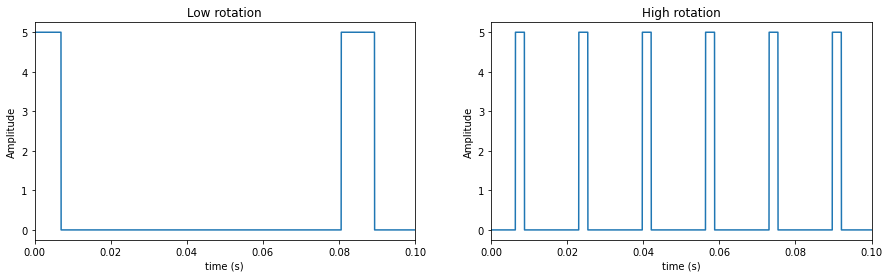

In [12]:
plt.figure(figsize=(15,4))
plt.subplot(121)
plt.plot(t,low_rotation)
plt.xlim(0,0.1)
plt.ylabel('Amplitude')
plt.xlabel('time (s)')
plt.title('Low rotation')
plt.subplot(122)
plt.plot(t,high_rotation)
plt.xlim(0,0.1)
plt.ylabel('Amplitude')
plt.xlabel('time (s)')
plt.title('High rotation')
plt.show()

### First try of getting the rotation frequency from an analog tachometer

In [13]:
# average rotation for n peaks of analog tachometer
def get_rotation(signal, n=10):
  peaks, count, temp, start = 0, 0, 5, False
  signal= filter(signal)
  
  for value in signal:
    if (temp==0) and (value== 5.0):
      start=True
      peaks+=1
      if peaks > n: break
    temp = value
    if start: count+=1
  return  n/(count*Ts)


In [14]:
get_rotation(tac6144.tachometer)

60.03842459173871

## Plotting FFT for aceleration columns

In [15]:
# Fast Fourier Transform (FFT)
def to_fft(y):
  return np.abs(fft.fft(y))[0:y.shape[0]//2] / (y.shape[0]//2)

In [16]:
def plot_fft(df, title=None):
  fig = go.Figure()
  for col in df.columns:
    y_fft= to_fft(df[col].values)
    fig.add_trace(go.Scatter(
        x=fft.fftfreq(df.shape[0],Ts),
        y= y_fft,
        name = col
    ))
  if title !=None:
    fig.update_layout(title=title)
  fig.show()

plot_fft(tac1229[['axial_1','radiale_1','tangential_1']], f'Normal ({get_rotation(tac1229.tachometer):.1f} Hz)')
plot_fft(tac6144[['axial_1','radiale_1','tangential_1']], f'Normal ({get_rotation(tac6144.tachometer):.1f} Hz)')